# CORN: Correlation-driven Nonparametric Learning Approach for Portfolio Selection

This notebook aims to implement the CORN algorithm in Python 3. CORN stands for **COR**relation-driven **N**onparametric and was first introduced by Bin Li, Steven C. H. Hoi and Vivek Gopalkrishnan in 2011.

*(LI, Bin; HOI, Steven C. H.; and Gopalkrishnan, Vivek. CORN: Correlation-driven Nonparametric Learning Approach for Portfolio Selection. (2011). ACM Transactions on Intelligent Systems and Technology. 2, (3),. Research Collection School Of Information Systems. Available at: http://ink.library.smu.edu.sg/sis_research/2265
)*

## Structure

1. Download data from yahoo finance
2. Data pre-processing and first glance
3. Introduction of CORN algorithm (Step 1 / Step 2)
4. Translation of CORN from pseudo-code to Python 3.x
5. Application of CORN on data set
6. Performance evaluation


### 1. Download data from yahoo finance

We define the investment universe as *U*. Since I want to avoid bias, in particular survivorship bias, at all cost, we will select ETF on the market which are tradeable for at least 15 years (before financial crisis). Apparently, this will point to the big and known names in the market:

* SPY	SPDR S&P 500 ETF Trust
* VTI	Vanguard Total Stock Market ETF
* QQQ	Invesco QQQ Trust
* EFA iShares MSCI EAFE ETF 
* AGG	iShares Core U.S. Aggregate Bond ETF
* VWO	Vanguard FTSE Emerging Markets ETF
* IJR iShares Core S&P Small-Cap ETF
* IJH iShares Core S&P Mid-Cap ETF 
* IWF iShares Russell 1000 Growth ETF
* GLD SPDR Gold Shares
* LQD iShares iBoxx $ Investment Grade Corporate Bond ETF 
* TLT iShares 20+ Year Treasury Bond ETF
* VNQ Vanguard Real Estate ETF 
* IEF iShares 7-10 Year Treasury Bond ETF 
* SHY iShares 1-3 Year Treasury Bond ETF 
* DIA SPDR Dow Jones Industrial Average ETF Trust 
* VGK Vanguard FTSE Europe ETF
* VB - Vanguard Small Cap Index Fund 
* EXS1.DE - iShares Core DAX UCITS ETF (DE) (EXS1.DE)
* CAC.PA - Lyxor CAC 40 (DR) UCITS ETF (CAC.PA)

In [1]:
import numpy as np
import pandas as pd
import yfinance as yf

investment_universe = ['SPY', 'VTI', 'QQQ', 'EFA', 'AGG', 'VWO', 'IJR', 'IJH', 'IWF', 'GLD', 'LQD', 'TLT', 'VNQ', 'IEF', 'SHY', 'DIA', 'VGK', 'VB', 'EXS1.DE', 'CAC.PA']
num_assets = len(investment_universe)

print(f'Assets in investment universe: {num_assets}')

Assets in investment universe: 20


### 2. Data pre-processing and first glance

In [2]:
df = yf.download(investment_universe, ignore_tz=True)['Adj Close']

#df.index = pd.to_datetime(df.index).date.astype(str)
#df.index.name = 'Date'
#df = df.reset_index() #its easier to work with int index
#df['Date'] = pd.to_datetime(df['Date']).dt.strftime('%Y-%m-%d')

# Check if at least 15x252 trading days are available (15 years * 252 trading days) 
trading_days = 15*252
non_null_counts = df.count()

for symbol in non_null_counts.index:
    if non_null_counts[symbol] < trading_days:
        print(f"Symbol {symbol} has less than {trading_days} non-null values: {non_null_counts[symbol]}")
    else:
        print(f"Ok! {symbol} has at least 15 years of data history ({non_null_counts[symbol]} days in total).")
        
# Prune whole df to match ETF with shortest history

min_counts = non_null_counts.min()
min_symbol = non_null_counts[non_null_counts == min_counts].index[0]
min_start_date = df[df[min_symbol].notnull()].index.min()
min_end_date = df[df[min_symbol].notnull()].index.max()
df = df.loc[(df.index >= min_start_date) & (df.index <= min_end_date)]
df = df.dropna()
#df = df.reset_index()
#df = df.drop(columns=['index'])
print(f"Shape of DataFrame after pruning: {df.shape}")

# Check if NaN values are in df

if df.isnull().values.any():
    print("NaN values present!")
else:
    print("DataFrame is clean.")
    
print(df.describe())

[*********************100%***********************]  20 of 20 completed
Ok! AGG has at least 15 years of data history (4905 days in total).
Ok! CAC.PA has at least 15 years of data history (3898 days in total).
Ok! DIA has at least 15 years of data history (6336 days in total).
Ok! EFA has at least 15 years of data history (5427 days in total).
Ok! EXS1.DE has at least 15 years of data history (3867 days in total).
Ok! GLD has at least 15 years of data history (4617 days in total).
Ok! IEF has at least 15 years of data history (5199 days in total).
Ok! IJH has at least 15 years of data history (5742 days in total).
Ok! IJR has at least 15 years of data history (5742 days in total).
Ok! IWF has at least 15 years of data history (5742 days in total).
Ok! LQD has at least 15 years of data history (5199 days in total).
Ok! QQQ has at least 15 years of data history (6050 days in total).
Ok! SHY has at least 15 years of data history (5199 days in total).
Ok! SPY has at least 15 years of data 

<IPython.core.display.Javascript object>


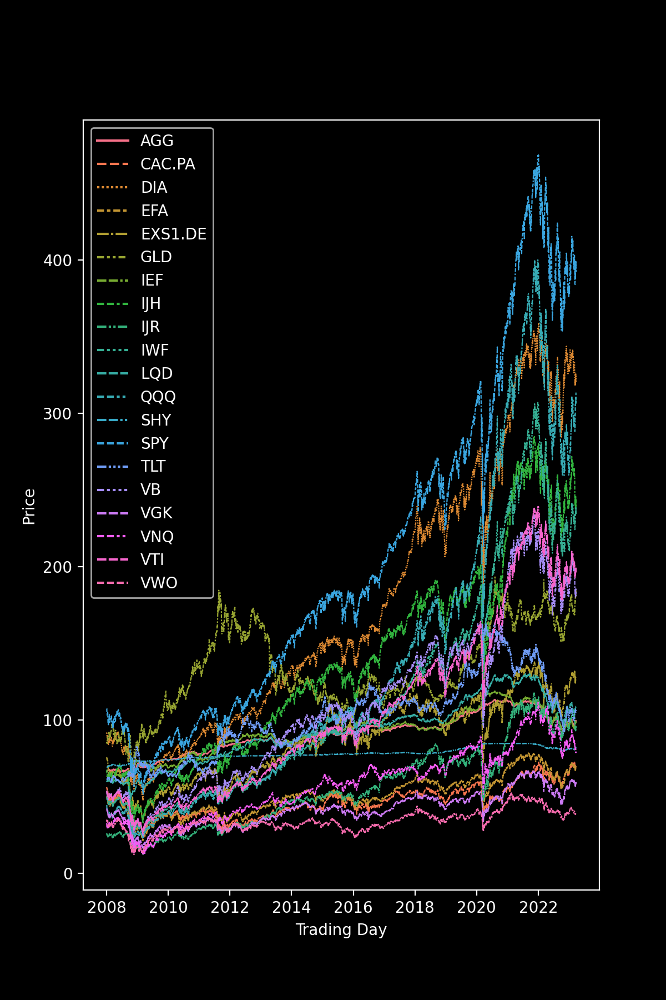

In [3]:
%matplotlib notebook
import matplotlib.pyplot as plt
import seaborn as sns


plt.style.use('dark_background')
plt.figure(figsize=(6, 9))
sns.lineplot(data=df, linewidth=0.8)
plt.ylabel('Price')
plt.xlabel('Trading Day')

plt.show()


Now we will generate the log-returns from the Adjusted Close Prices and look at some first statistics.

In [4]:
print(df.dtypes)
print(df.head(2))

AGG        float64
CAC.PA     float64
DIA        float64
EFA        float64
EXS1.DE    float64
GLD        float64
IEF        float64
IJH        float64
IJR        float64
IWF        float64
LQD        float64
QQQ        float64
SHY        float64
SPY        float64
TLT        float64
VB         float64
VGK        float64
VNQ        float64
VTI        float64
VWO        float64
dtype: object
                  AGG     CAC.PA        DIA        EFA    EXS1.DE        GLD  \
Date                                                                           
2008-01-02  66.375053  56.270000  91.568184  50.166683  75.739998  84.860001   
2008-01-03  66.551384  55.639999  91.645287  50.250057  75.349998  85.570000   

                  IEF        IJH        IJR        IWF        LQD        QQQ  \
Date                                                                           
2008-01-02  62.749672  67.633163  26.315685  49.838951  60.017677  44.125835   
2008-01-03  62.878605  67.088257  25.980560  

<IPython.core.display.Javascript object>


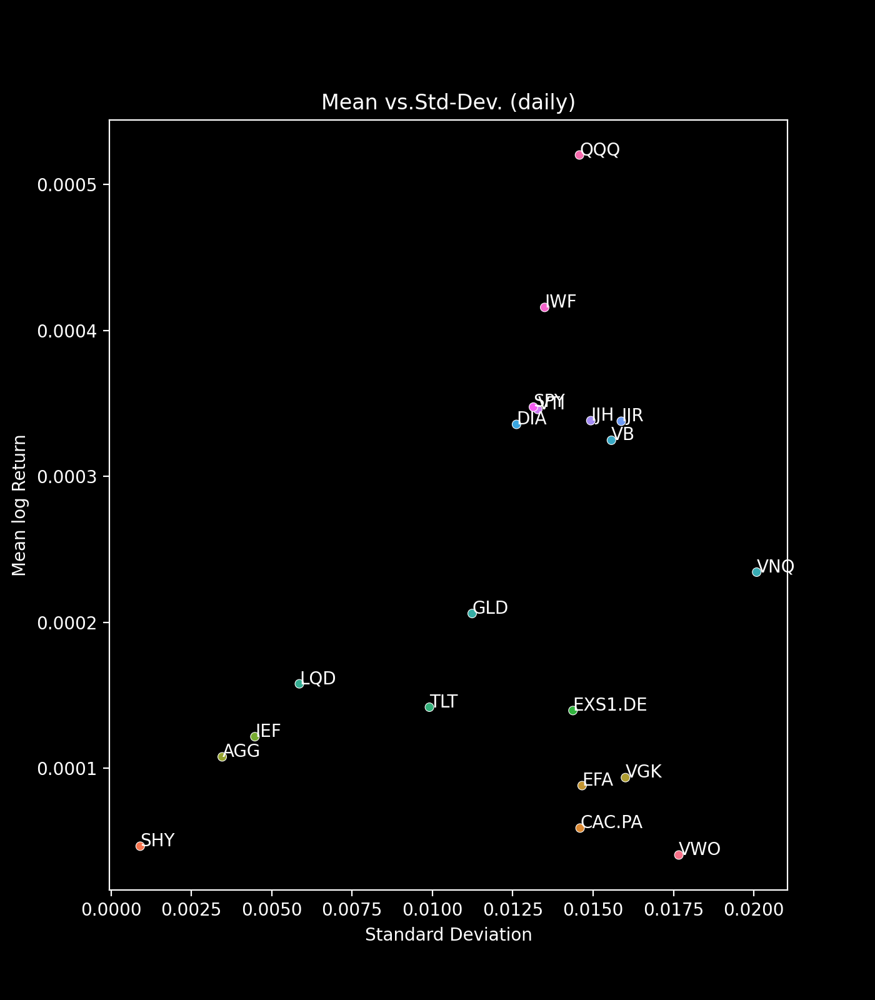

In [5]:
log_returns = np.log(df / df.shift(1)).dropna()

#lets put both the returns and std into an ordered list and plot the values to get a first glance of our investment universe and how each individual asset performaned

return_ol = log_returns.mean().sort_values()
std_ol = log_returns.std().sort_values()
sr_ol = (return_ol/std_ol).sort_values()
risk_return_ol = pd.concat([return_ol, std_ol], axis=1)
risk_return_ol.columns = ['mean', 'std']


plt.style.use('dark_background')
plt.figure(figsize=(7, 8))
ax = sns.scatterplot(x=risk_return_ol['std'], y=risk_return_ol['mean'], hue=risk_return_ol.index, s=25, alpha=1, legend=False)
plt.xlabel('Standard Deviation')
plt.ylabel('Mean log Return')
plt.title('Mean vs.Std-Dev. (daily)')

for i, symbol in enumerate(risk_return_ol.index):
    ax.text(risk_return_ol.iloc[i]['std'], risk_return_ol.iloc[i]['mean'], symbol, fontsize=10)


plt.show()


QQQ performed best, given that this is Invesco's fund rebuilding the NASDAQ100 that was expected. SHY on the otherside rebuilds the 1 to 3 year maturity treasuries, given the 0-interest rate regime in the past years, this plausible as well. Lets plot a Bar-Chart to get a better view on the returns and std.

<IPython.core.display.Javascript object>


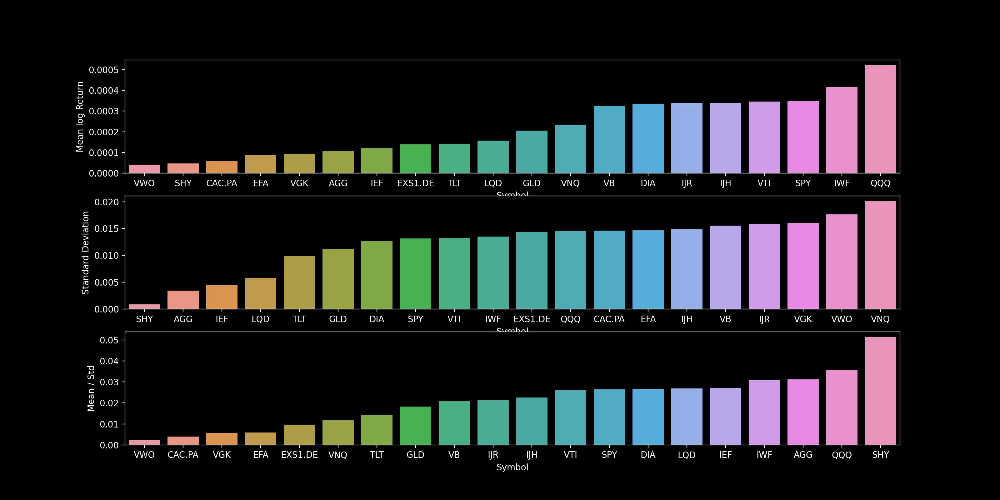

In [6]:
# Assuming return_ol and std_ol are your ordered lists
plt.style.use('dark_background')
fig, (ax1, ax2, ax3) = plt.subplots(nrows=3, figsize=(16,8))

# Plot for return_ol
sns.barplot(x=return_ol.index, y=return_ol.values, ax=ax1)
ax1.set_xlabel('Symbol')
ax1.set_ylabel('Mean log Return')

# Plot for std_ol
sns.barplot(x=std_ol.index, y=std_ol.values, ax=ax2)
ax2.set_xlabel('Symbol')
ax2.set_ylabel('Standard Deviation')

# Plot for sr_ol
sns.barplot(x=sr_ol.index, y=sr_ol.values, ax=ax3)
ax3.set_xlabel('Symbol')
ax3.set_ylabel('Mean / Std')

plt.show()

### 3. Introduction of CORN algorithm (Step 1 / Step 2)

So, what is CORN actually? In particular, CORN seeks to **locate the market windows that are similar to the latest market window, and makes a log-optimum portfolio according to the idea of the best Constant Rebalanced Portfolio strategy (BCRP) [Cover and Gluss 1986].** CORN not only exploits effective statistical correlations between market windows, but also benefits from the exploration of powerful nonparametric machine learning techniques. Be aware: the BCRP only works in hindsight. But since we are using solely the past to estimate meaningful weights for the future, that is a meaningful and proper solution.

How does the algorithm work?
The first step is to define *experts* whose tasks are to locate the similar historical price relatives and learn to find an optimal portfolio based on the similar historical price relatives. The second step is to effectively combine the portfolios produced by the experts to form the final portfolio.


### 4. Step 1 - Experts and correlation-similiar sets 

We first start by defining a set of infinite experts, each expert indexed by $(w, ρ)$, i.e., ${E(w,ρ) : w ≥ 1,−1 ≤ ρ ≤ 1}$. The expert $E(w,ρ)$ is identified by its **window size $w$ and correlation coefficient threshold $ρ$**. 

Empirically, the infinite set of experts could be fixed to a finite number $W × P$ , where $W$ represents the maximum window size and $P$ represents the number of correlation coefficient thresholds. In general, we can define an expert $E(w, ρ)$ as $E(w, ρ) = b(w, ρ)$.

For each expert $E(w, ρ)$, after calculating the correlation-similar set $Ct(w, ρ)$ at the beginning of $t$-th trading day, we propose to learn the optimal portfolio by maximizing the total wealth over the sequence of price relatives by following the similar idea of the BCRP strategy [Cover and Gluss 1986], i.e.,

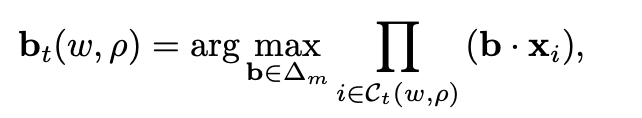

where $\Delta m$ represents a simplex with $m$ components. It is possible that $C_t(w, ρ)$ is empty for a large $ρ$ value, for which we will simply adopt a uniform portfolio $(\frac{1}{m}, ..., \frac{1}{m}) $ . Moreover, the correlation-similar set usually consists of a large number of correlated price relatives. Thus, if some price relative (whose correlation is within the threshold) has occurred frequently in the history, it will also appear multiple times in the correlation-similar set.


In [16]:
# Implementation of CORN - Step 1 in Python

win = 20 # window size
rho = 0.2 # correlation coefficient threshold

def get_expert_portfolio(returns: pd.DataFrame, win: int, rho: float) -> pd.DataFrame():
    
    '''
    The CORN Expert function to identify correlation-similiar sets in the log_return matrix and optimize asset weights based on those sets
    '''
    print(f'Received: {len(returns)} data points')
    
    if len(returns) <= win:
        pass
    
    else:
    
        m = len(returns.columns) # number of assets
        t = returns.index[-1] # Index of current trading day
        C_t = set() # correlation-similiar set
        indices = [] # used to identify the window later for simplex optimization

        for i in range(win, len(returns)-2*win): # 2*window because we add win later again. If we wouldnt do this this would lead to a perfect correlated past_market_window
            print(f'Received {len(returns)} data points. Current trading day: {t}')
            current_market_window = returns.iloc[:-win]
            print("current market window")
            print(current_market_window)
            past_market_window = returns.iloc[i:i+win] # X_t_n

            start_date_past_market_window = past_market_window.index[0]
            end_date_past_market_window = past_market_window.index[-1]

            #print(f'Calculating correlation for past_market_window: {start_date_past_market_window} - {end_date_past_market_window}')

            #corr_matrix = np.corrcoef(current_market_window.T, past_market_window.T)

            # extract the correlation coefficient between the two windows
            #corr_coeff = corr_matrix[0,1]


for t in range(0, len(log_returns)):
    
    current_history = log_returns[:t]
    print(f'Iteration {t}, Length of current_history: {len(current_history)}')
    get_expert_portfolio(returns=current_history, win=win, rho=rho)


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-03-28  0.002433  0.009129 -0.007499 -0.000837 -0.002877 -0.017050   
2008-03-31 -0.001557 -0.005085  0.001390  0.003623 -0.003688 -0.016128   
2008-04-01 -0.006819  0.002334  0.029543  0.031083  0.027881 -0.040057   
2008-04-02  0.000492  0.033138  0.000952  0.002155  0.008401  0.027368   
2008-04-03  0.003144  0.009386  0.001109  0.002955 -0.005281  0.001679   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-02  0.000492  0.033138  0.000952  0.002155  0.008401  0.027368   
2008-04-03  0.003144  0.009386  0.001109  0.002955 -0.005281  0.001679   
2008-04-04  0.005088 -0.004886 -0.001822  0.003348  0.003265  0.009239   
2008-04-07 -0.000097  0.002650 -0.000397  0.006131  0.008502  0.010142   
2008-04-08 -0.000097  0.008916  0.000634 -0.010552 -0.007260 -0.009035   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-03  0.003144  0.009386  0.001109  0.002955 -0.005281  0.001679   
2008-04-04  0.005088 -0.004886 -0.001822  0.003348  0.003265  0.009239   
2008-04-07 -0.000097  0.002650 -0.000397  0.006131  0.008502  0.010142   
2008-04-08 -0.000097  0.008916  0.000634 -0.010552 -0.007260 -0.009035   
2008-04-09  0.004383 -0.006476 -0.003812 -0.008225 -0.007470  0.021245   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-07 -0.000097  0.002650 -0.000397  0.006131  0.008502  0.010142   
2008-04-08 -0.000097  0.008916  0.000634 -0.010552 -0.007260 -0.009035   
2008-04-09  0.004383 -0.006476 -0.003812 -0.008225 -0.007470  0.021245   
2008-04-10 -0.003115 -0.007746  0.002384 -0.003119 -0.002502 -0.005650   
2008-04-11  0.002143 -0.003074 -0.020940 -0.013537 -0.015147 -0.005135   

                 IEF       IJH       

Received 89 data points. Current trading day: 2008-05-13 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-08 -0.000097  0.008916  0.000634 -0.010552 -0.007260 -0.009035   
2008-04-09  0.004383 -0.006476 -0.003812 -0.008225 -0.007470  0.021245   
2008-04-10 -0.003115 -0.007746  0.002384 -0.003119 -0.002502 -0.005650   
2008-04-11  0.002143 -0.003074 -0.020940 -0.013537 -0.015147 -0.005135   
2008-04-14 -0.001168 -0.

Received 91 data points. Current trading day: 2008-05-15 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-10 -0.003115 -0.007746  0.002384 -0.003119 -0.002502 -0.005650   
2008-04-11  0.002143 -0.003074 -0.020940 -0.013537 -0.015147 -0.005135   
2008-04-14 -0.001168 -0.012808 -0.001379  0.002200 -0.007500 -0.002083   
2008-04-15 -0.005371 -0.006466  0.002514  0.006981  0.004634  0.006019   
2008-04-16 -0.003630  0.

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-11  0.002143 -0.003074 -0.020940 -0.013537 -0.015147 -0.005135   
2008-04-14 -0.001168 -0.012808 -0.001379  0.002200 -0.007500 -0.002083   
2008-04-15 -0.005371 -0.006466  0.002514  0.006981  0.004634  0.006019   
2008-04-16 -0.003630  0.002925  0.025269  0.031024  0.017700  0.017412   
2008-04-17 -0.000196  0.015321  0.000474 -0.011170 -0.003138 -0.007641   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-14 -0.001168 -0.012808 -0.001379  0.002200 -0.007500 -0.002083   
2008-04-15 -0.005371 -0.006466  0.002514  0.006981  0.004634  0.006019   
2008-04-16 -0.003630  0.002925  0.025269  0.031024  0.017700  0.017412   
2008-04-17 -0.000196  0.015321  0.000474 -0.011170 -0.003138 -0.007641   
2008-04-18  0.002650  0.001437  0.010346  0.007063  0.023910 -0.021182   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-15 -0.005371 -0.006466  0.002514  0.006981  0.004634  0.006019   
2008-04-16 -0.003630  0.002925  0.025269  0.031024  0.017700  0.017412   
2008-04-17 -0.000196  0.015321  0.000474 -0.011170 -0.003138 -0.007641   
2008-04-18  0.002650  0.001437  0.010346  0.007063  0.023910 -0.021182   
2008-04-21  0.000098  0.020912  0.001329  0.007804 -0.008319 -0.004091   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-16 -0.003630  0.002925  0.025269  0.031024  0.017700  0.017412   
2008-04-17 -0.000196  0.015321  0.000474 -0.011170 -0.003138 -0.007641   
2008-04-18  0.002650  0.001437  0.010346  0.007063  0.023910 -0.021182   
2008-04-21  0.000098  0.020912  0.001329  0.007804 -0.008319 -0.004091   
2008-04-22  0.001470 -0.010097 -0.005169 -0.010463 -0.008701  0.000222   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-17 -0.000196  0.015321  0.000474 -0.011170 -0.003138 -0.007641   
2008-04-18  0.002650  0.001437  0.010346  0.007063  0.023910 -0.021182   
2008-04-21  0.000098  0.020912  0.001329  0.007804 -0.008319 -0.004091   
2008-04-22  0.001470 -0.010097 -0.005169 -0.010463 -0.008701  0.000222   
2008-04-23 -0.000980 -0.007743 -0.000549  0.005179  0.009938 -0.011700   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-18  0.002650  0.001437  0.010346  0.007063  0.023910 -0.021182   
2008-04-21  0.000098  0.020912  0.001329  0.007804 -0.008319 -0.004091   
2008-04-22  0.001470 -0.010097 -0.005169 -0.010463 -0.008701  0.000222   
2008-04-23 -0.000980 -0.007743 -0.000549  0.005179  0.009938 -0.011700   
2008-04-24 -0.003730  0.014620  0.006264 -0.006511  0.003855 -0.022672   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-21  0.000098  0.020912  0.001329  0.007804 -0.008319 -0.004091   
2008-04-22  0.001470 -0.010097 -0.005169 -0.010463 -0.008701  0.000222   
2008-04-23 -0.000980 -0.007743 -0.000549  0.005179  0.009938 -0.011700   
2008-04-24 -0.003730  0.014620  0.006264 -0.006511  0.003855 -0.022672   
2008-04-25 -0.000984 -0.000807  0.005450  0.008232  0.010869  0.000573   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-21  0.000098  0.020912  0.001329  0.007804 -0.008319 -0.004091   
2008-04-22  0.001470 -0.010097 -0.005169 -0.010463 -0.008701  0.000222   
2008-04-23 -0.000980 -0.007743 -0.000549  0.005179  0.009938 -0.011700   
2008-04-24 -0.003730  0.014620  0.006264 -0.006511  0.003855 -0.022672   
2008-04-25 -0.000984 -0.000807  0.005450  0.008232  0.010869  0.000573   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-22  0.001470 -0.010097 -0.005169 -0.010463 -0.008701  0.000222   
2008-04-23 -0.000980 -0.007743 -0.000549  0.005179  0.009938 -0.011700   
2008-04-24 -0.003730  0.014620  0.006264 -0.006511  0.003855 -0.022672   
2008-04-25 -0.000984 -0.000807  0.005450  0.008232  0.010869  0.000573   
2008-04-28  0.002459  0.011034 -0.000077  0.005801  0.004254  0.004801   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-23 -0.000980 -0.007743 -0.000549  0.005179  0.009938 -0.011700   
2008-04-24 -0.003730  0.014620  0.006264 -0.006511  0.003855 -0.022672   
2008-04-25 -0.000984 -0.000807  0.005450  0.008232  0.010869  0.000573   
2008-04-28  0.002459  0.011034 -0.000077  0.005801  0.004254  0.004801   
2008-04-29  0.001472  0.007157 -0.004748 -0.008847 -0.005778 -0.021672   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-24 -0.003730  0.014620  0.006264 -0.006511  0.003855 -0.022672   
2008-04-25 -0.000984 -0.000807  0.005450  0.008232  0.010869  0.000573   
2008-04-28  0.002459  0.011034 -0.000077  0.005801  0.004254  0.004801   
2008-04-29  0.001472  0.007157 -0.004748 -0.008847 -0.005778 -0.021672   
2008-04-30  0.006061 -0.006958  0.000078  0.005423  0.009108  0.009742   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-25 -0.000984 -0.000807  0.005450  0.008232  0.010869  0.000573   
2008-04-28  0.002459  0.011034 -0.000077  0.005801  0.004254  0.004801   
2008-04-29  0.001472  0.007157 -0.004748 -0.008847 -0.005778 -0.021672   
2008-04-30  0.006061 -0.006958  0.000078  0.005423  0.009108  0.009742   
2008-05-02 -0.003369  0.003783  0.019621  0.008799  0.006326 -0.024179   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-28  0.002459  0.011034 -0.000077  0.005801  0.004254  0.004801   
2008-04-29  0.001472  0.007157 -0.004748 -0.008847 -0.005778 -0.021672   
2008-04-30  0.006061 -0.006958  0.000078  0.005423  0.009108  0.009742   
2008-05-02 -0.003369  0.003783  0.019621  0.008799  0.006326 -0.024179   
2008-05-05  0.000393  0.014599 -0.008450  0.001698  0.001201  0.019784   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-29  0.001472  0.007157 -0.004748 -0.008847 -0.005778 -0.021672   
2008-04-30  0.006061 -0.006958  0.000078  0.005423  0.009108  0.009742   
2008-05-02 -0.003369  0.003783  0.019621  0.008799  0.006326 -0.024179   
2008-05-05  0.000393  0.014599 -0.008450  0.001698  0.001201  0.019784   
2008-05-06 -0.003241 -0.001372  0.004772  0.007413 -0.004961  0.004164   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-04-30  0.006061 -0.006958  0.000078  0.005423  0.009108  0.009742   
2008-05-02 -0.003369  0.003783  0.019621  0.008799  0.006326 -0.024179   
2008-05-05  0.000393  0.014599 -0.008450  0.001698  0.001201  0.019784   
2008-05-06 -0.003241 -0.001372  0.004772  0.007413 -0.004961  0.004164   
2008-05-07  0.002849 -0.004324 -0.014306 -0.017646  0.008405 -0.009394   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-02 -0.003369  0.003783  0.019621  0.008799  0.006326 -0.024179   
2008-05-05  0.000393  0.014599 -0.008450  0.001698  0.001201  0.019784   
2008-05-06 -0.003241 -0.001372  0.004772  0.007413 -0.004961  0.004164   
2008-05-07  0.002849 -0.004324 -0.014306 -0.017646  0.008405 -0.009394   
2008-05-08  0.002547  0.006675 -0.001247  0.008666 -0.000598  0.016411   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-05  0.000393  0.014599 -0.008450  0.001698  0.001201  0.019784   
2008-05-06 -0.003241 -0.001372  0.004772  0.007413 -0.004961  0.004164   
2008-05-07  0.002849 -0.004324 -0.014306 -0.017646  0.008405 -0.009394   
2008-05-08  0.002547  0.006675 -0.001247  0.008666 -0.000598  0.016411   
2008-05-09  0.000391 -0.003724 -0.005786 -0.008007 -0.009768  0.002061   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-06 -0.003241 -0.001372  0.004772  0.007413 -0.004961  0.004164   
2008-05-07  0.002849 -0.004324 -0.014306 -0.017646  0.008405 -0.009394   
2008-05-08  0.002547  0.006675 -0.001247  0.008666 -0.000598  0.016411   
2008-05-09  0.000391 -0.003724 -0.005786 -0.008007 -0.009768  0.002061   
2008-05-12 -0.001762 -0.014839  0.009833  0.009966  0.004670 -0.004931   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-07  0.002849 -0.004324 -0.014306 -0.017646  0.008405 -0.009394   
2008-05-08  0.002547  0.006675 -0.001247  0.008666 -0.000598  0.016411   
2008-05-09  0.000391 -0.003724 -0.005786 -0.008007 -0.009768  0.002061   
2008-05-12 -0.001762 -0.014839  0.009833  0.009966  0.004670 -0.004931   
2008-05-13 -0.005700  0.003979 -0.002722 -0.003398  0.003451 -0.018564   

                 IEF       IJH       

Received 109 data points. Current trading day: 2008-06-11 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-07  0.002849 -0.004324 -0.014306 -0.017646  0.008405 -0.009394   
2008-05-08  0.002547  0.006675 -0.001247  0.008666 -0.000598  0.016411   
2008-05-09  0.000391 -0.003724 -0.005786 -0.008007 -0.009768  0.002061   
2008-05-12 -0.001762 -0.014839  0.009833  0.009966  0.004670 -0.004931   
2008-05-13 -0.005700  0

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-09  0.000391 -0.003724 -0.005786 -0.008007 -0.009768  0.002061   
2008-05-12 -0.001762 -0.014839  0.009833  0.009966  0.004670 -0.004931   
2008-05-13 -0.005700  0.003979 -0.002722 -0.003398  0.003451 -0.018564   
2008-05-14  0.001478  0.004358  0.004584  0.000000  0.003290 -0.002228   
2008-05-15  0.005299  0.011595  0.008107  0.016877 -0.000299  0.020907   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-12 -0.001762 -0.014839  0.009833  0.009966  0.004670 -0.004931   
2008-05-13 -0.005700  0.003979 -0.002722 -0.003398  0.003451 -0.018564   
2008-05-14  0.001478  0.004358  0.004584  0.000000  0.003290 -0.002228   
2008-05-15  0.005299  0.011595  0.008107  0.016877 -0.000299  0.020907   
2008-05-16 -0.002450  0.000781 -0.000940  0.010755  0.010548  0.023851   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-13 -0.005700  0.003979 -0.002722 -0.003398  0.003451 -0.018564   
2008-05-14  0.001478  0.004358  0.004584  0.000000  0.003290 -0.002228   
2008-05-15  0.005299  0.011595  0.008107  0.016877 -0.000299  0.020907   
2008-05-16 -0.002450  0.000781 -0.000940  0.010755  0.010548  0.023851   
2008-05-19  0.001667  0.006422  0.004849 -0.004084  0.009706  0.003249   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-14  0.001478  0.004358  0.004584  0.000000  0.003290 -0.002228   
2008-05-15  0.005299  0.011595  0.008107  0.016877 -0.000299  0.020907   
2008-05-16 -0.002450  0.000781 -0.000940  0.010755  0.010548  0.023851   
2008-05-19  0.001667  0.006422  0.004849 -0.004084  0.009706  0.003249   
2008-05-20  0.002152  0.012339 -0.014853 -0.009250 -0.015040  0.016751   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-15  0.005299  0.011595  0.008107  0.016877 -0.000299  0.020907   
2008-05-16 -0.002450  0.000781 -0.000940  0.010755  0.010548  0.023851   
2008-05-19  0.001667  0.006422  0.004849 -0.004084  0.009706  0.003249   
2008-05-20  0.002152  0.012339 -0.014853 -0.009250 -0.015040  0.016751   
2008-05-21 -0.001369 -0.013503 -0.017691 -0.011422 -0.010905  0.011594   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-15  0.005299  0.011595  0.008107  0.016877 -0.000299  0.020907   
2008-05-16 -0.002450  0.000781 -0.000940  0.010755  0.010548  0.023851   
2008-05-19  0.001667  0.006422  0.004849 -0.004084  0.009706  0.003249   
2008-05-20  0.002152  0.012339 -0.014853 -0.009250 -0.015040  0.016751   
2008-05-21 -0.001369 -0.013503 -0.017691 -0.011422 -0.010905  0.011594   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-19  0.001667  0.006422  0.004849 -0.004084  0.009706  0.003249   
2008-05-20  0.002152  0.012339 -0.014853 -0.009250 -0.015040  0.016751   
2008-05-21 -0.001369 -0.013503 -0.017691 -0.011422 -0.010905  0.011594   
2008-05-22 -0.005989 -0.004867 -0.000316  0.011551  0.004047 -0.010714   
2008-05-23  0.003833  0.001560 -0.011253 -0.011421 -0.017961  0.002744   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-20  0.002152  0.012339 -0.014853 -0.009250 -0.015040  0.016751   
2008-05-21 -0.001369 -0.013503 -0.017691 -0.011422 -0.010905  0.011594   
2008-05-22 -0.005989 -0.004867 -0.000316  0.011551  0.004047 -0.010714   
2008-05-23  0.003833  0.001560 -0.011253 -0.011421 -0.017961  0.002744   
2008-05-27 -0.005607 -0.014129  0.006560 -0.001960  0.002130 -0.020711   

                 IEF       IJH       

current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-21 -0.001369 -0.013503 -0.017691 -0.011422 -0.010905  0.011594   
2008-05-22 -0.005989 -0.004867 -0.000316  0.011551  0.004047 -0.010714   
2008-05-23  0.003833  0.001560 -0.011253 -0.011421 -0.017961  0.002744   
2008-05-27 -0.005607 -0.014129  0.006560 -0.001960  0.002130 -0.020711   
2008-05-28 -0.004648 -0.004953  0.003263 -0.000131  0.010732 -0.002465   

               

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-22 -0.005989 -0.004867 -0.000316  0.011551  0.004047 -0.010714   
2008-05-23  0.003833  0.001560 -0.011253 -0.011421 -0.017961  0.002744   
2008-05-27 -0.005607 -0.014129  0.006560 -0.001960  0.002130 -0.020711   
2008-05-28 -0.004648 -0.004953  0.003263 -0.000131  0.010732 -0.002465   
2008-05-29 -0.002778  0.013023  0.003095 -0.002226  0.003003 -0.029948   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-23  0.003833  0.001560 -0.011253 -0.011421 -0.017961  0.002744   
2008-05-27 -0.005607 -0.014129  0.006560 -0.001960  0.002130 -0.020711   
2008-05-28 -0.004648 -0.004953  0.003263 -0.000131  0.010732 -0.002465   
2008-05-29 -0.002778  0.013023  0.003095 -0.002226  0.003003 -0.029948   
2008-05-30  0.003572  0.003523 -0.000793  0.005621  0.005829  0.010807   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-27 -0.005607 -0.014129  0.006560 -0.001960  0.002130 -0.020711   
2008-05-28 -0.004648 -0.004953  0.003263 -0.000131  0.010732 -0.002465   
2008-05-29 -0.002778  0.013023  0.003095 -0.002226  0.003003 -0.029948   
2008-05-30  0.003572  0.003523 -0.000793  0.005621  0.005829  0.010807   
2008-06-02  0.003711  0.007784 -0.007720 -0.010483 -0.012447  0.005815   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-27 -0.005607 -0.014129  0.006560 -0.001960  0.002130 -0.020711   
2008-05-28 -0.004648 -0.004953  0.003263 -0.000131  0.010732 -0.002465   
2008-05-29 -0.002778  0.013023  0.003095 -0.002226  0.003003 -0.029948   
2008-05-30  0.003572  0.003523 -0.000793  0.005621  0.005829  0.010807   
2008-06-02  0.003711  0.007784 -0.007720 -0.010483 -0.012447  0.005815   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-28 -0.004648 -0.004953  0.003263 -0.000131  0.010732 -0.002465   
2008-05-29 -0.002778  0.013023  0.003095 -0.002226  0.003003 -0.029948   
2008-05-30  0.003572  0.003523 -0.000793  0.005621  0.005829  0.010807   
2008-06-02  0.003711  0.007784 -0.007720 -0.010483 -0.012447  0.005815   
2008-06-03  0.001880 -0.015235 -0.009634 -0.002110  0.001508 -0.012354   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-29 -0.002778  0.013023  0.003095 -0.002226  0.003003 -0.029948   
2008-05-30  0.003572  0.003523 -0.000793  0.005621  0.005829  0.010807   
2008-06-02  0.003711  0.007784 -0.007720 -0.010483 -0.012447  0.005815   
2008-06-03  0.001880 -0.015235 -0.009634 -0.002110  0.001508 -0.012354   
2008-06-04 -0.003565  0.009987  0.000242 -0.005826 -0.007714 -0.002651   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-30  0.003572  0.003523 -0.000793  0.005621  0.005829  0.010807   
2008-06-02  0.003711  0.007784 -0.007720 -0.010483 -0.012447  0.005815   
2008-06-03  0.001880 -0.015235 -0.009634 -0.002110  0.001508 -0.012354   
2008-06-04 -0.003565  0.009987  0.000242 -0.005826 -0.007714 -0.002651   
2008-06-05 -0.003678 -0.013339  0.016954  0.016462 -0.003346 -0.002311   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-05-30  0.003572  0.003523 -0.000793  0.005621  0.005829  0.010807   
2008-06-02  0.003711  0.007784 -0.007720 -0.010483 -0.012447  0.005815   
2008-06-03  0.001880 -0.015235 -0.009634 -0.002110  0.001508 -0.012354   
2008-06-04 -0.003565  0.009987  0.000242 -0.005826 -0.007714 -0.002651   
2008-06-05 -0.003678 -0.013339  0.016954  0.016462 -0.003346 -0.002311   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-02  0.003711  0.007784 -0.007720 -0.010483 -0.012447  0.005815   
2008-06-03  0.001880 -0.015235 -0.009634 -0.002110  0.001508 -0.012354   
2008-06-04 -0.003565  0.009987  0.000242 -0.005826 -0.007714 -0.002651   
2008-06-05 -0.003678 -0.013339  0.016954  0.016462 -0.003346 -0.002311   
2008-06-06  0.005561 -0.001779 -0.032150 -0.029156 -0.020159  0.029744   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-02  0.003711  0.007784 -0.007720 -0.010483 -0.012447  0.005815   
2008-06-03  0.001880 -0.015235 -0.009634 -0.002110  0.001508 -0.012354   
2008-06-04 -0.003565  0.009987  0.000242 -0.005826 -0.007714 -0.002651   
2008-06-05 -0.003678 -0.013339  0.016954  0.016462 -0.003346 -0.002311   
2008-06-06  0.005561 -0.001779 -0.032150 -0.029156 -0.020159  0.029744   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-03  0.001880 -0.015235 -0.009634 -0.002110  0.001508 -0.012354   
2008-06-04 -0.003565  0.009987  0.000242 -0.005826 -0.007714 -0.002651   
2008-06-05 -0.003678 -0.013339  0.016954  0.016462 -0.003346 -0.002311   
2008-06-06  0.005561 -0.001779 -0.032150 -0.029156 -0.020159  0.029744   
2008-06-09 -0.005063 -0.022203  0.006855 -0.001346  0.001708 -0.012087   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-04 -0.003565  0.009987  0.000242 -0.005826 -0.007714 -0.002651   
2008-06-05 -0.003678 -0.013339  0.016954  0.016462 -0.003346 -0.002311   
2008-06-06  0.005561 -0.001779 -0.032150 -0.029156 -0.020159  0.029744   
2008-06-09 -0.005063 -0.022203  0.006855 -0.001346  0.001708 -0.012087   
2008-06-10 -0.005289  0.000809  0.000000 -0.017113 -0.006539 -0.028122   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-05 -0.003678 -0.013339  0.016954  0.016462 -0.003346 -0.002311   
2008-06-06  0.005561 -0.001779 -0.032150 -0.029156 -0.020159  0.029744   
2008-06-09 -0.005063 -0.022203  0.006855 -0.001346  0.001708 -0.012087   
2008-06-10 -0.005289  0.000809  0.000000 -0.017113 -0.006539 -0.028122   
2008-06-11  0.001300 -0.007913 -0.015656 -0.012822 -0.017967  0.017037   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-05 -0.003678 -0.013339  0.016954  0.016462 -0.003346 -0.002311   
2008-06-06  0.005561 -0.001779 -0.032150 -0.029156 -0.020159  0.029744   
2008-06-09 -0.005063 -0.022203  0.006855 -0.001346  0.001708 -0.012087   
2008-06-10 -0.005289  0.000809  0.000000 -0.017113 -0.006539 -0.028122   
2008-06-11  0.001300 -0.007913 -0.015656 -0.012822 -0.017967  0.017037   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-06  0.005561 -0.001779 -0.032150 -0.029156 -0.020159  0.029744   
2008-06-09 -0.005063 -0.022203  0.006855 -0.001346  0.001708 -0.012087   
2008-06-10 -0.005289  0.000809  0.000000 -0.017113 -0.006539 -0.028122   
2008-06-11  0.001300 -0.007913 -0.015656 -0.012822 -0.017967  0.017037   
2008-06-12 -0.006215 -0.020165  0.004780 -0.003475  0.009654 -0.016453   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-06  0.005561 -0.001779 -0.032150 -0.029156 -0.020159  0.029744   
2008-06-09 -0.005063 -0.022203  0.006855 -0.001346  0.001708 -0.012087   
2008-06-10 -0.005289  0.000809  0.000000 -0.017113 -0.006539 -0.028122   
2008-06-11  0.001300 -0.007913 -0.015656 -0.012822 -0.017967  0.017037   
2008-06-12 -0.006215 -0.020165  0.004780 -0.003475  0.009654 -0.016453   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-09 -0.005063 -0.022203  0.006855 -0.001346  0.001708 -0.012087   
2008-06-10 -0.005289  0.000809  0.000000 -0.017113 -0.006539 -0.028122   
2008-06-11  0.001300 -0.007913 -0.015656 -0.012822 -0.017967  0.017037   
2008-06-12 -0.006215 -0.020165  0.004780 -0.003475  0.009654 -0.016453   
2008-06-13 -0.002517  0.002284  0.012013  0.009148  0.007532  0.002683   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-10 -0.005289  0.000809  0.000000 -0.017113 -0.006539 -0.028122   
2008-06-11  0.001300 -0.007913 -0.015656 -0.012822 -0.017967  0.017037   
2008-06-12 -0.006215 -0.020165  0.004780 -0.003475  0.009654 -0.016453   
2008-06-13 -0.002517  0.002284  0.012013  0.009148  0.007532  0.002683   
2008-06-16  0.001109  0.002485 -0.003580  0.005092 -0.005329  0.013654   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-10 -0.005289  0.000809  0.000000 -0.017113 -0.006539 -0.028122   
2008-06-11  0.001300 -0.007913 -0.015656 -0.012822 -0.017967  0.017037   
2008-06-12 -0.006215 -0.020165  0.004780 -0.003475  0.009654 -0.016453   
2008-06-13 -0.002517  0.002284  0.012013  0.009148  0.007532  0.002683   
2008-06-16  0.001109  0.002485 -0.003580  0.005092 -0.005329  0.013654   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-11  0.001300 -0.007913 -0.015656 -0.012822 -0.017967  0.017037   
2008-06-12 -0.006215 -0.020165  0.004780 -0.003475  0.009654 -0.016453   
2008-06-13 -0.002517  0.002284  0.012013  0.009148  0.007532  0.002683   
2008-06-16  0.001109  0.002485 -0.003580  0.005092 -0.005329  0.013654   
2008-06-17  0.003417 -0.004354 -0.005968  0.003015  0.009852  0.002754   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-11  0.001300 -0.007913 -0.015656 -0.012822 -0.017967  0.017037   
2008-06-12 -0.006215 -0.020165  0.004780 -0.003475  0.009654 -0.016453   
2008-06-13 -0.002517  0.002284  0.012013  0.009148  0.007532  0.002683   
2008-06-16  0.001109  0.002485 -0.003580  0.005092 -0.005329  0.013654   
2008-06-17  0.003417 -0.004354 -0.005968  0.003015  0.009852  0.002754   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-13 -0.002517  0.002284  0.012013  0.009148  0.007532  0.002683   
2008-06-16  0.001109  0.002485 -0.003580  0.005092 -0.005329  0.013654   
2008-06-17  0.003417 -0.004354 -0.005968  0.003015  0.009852  0.002754   
2008-06-18  0.004206  0.005801 -0.013210 -0.008245 -0.010010  0.011736   
2008-06-19 -0.005109 -0.013937  0.002490 -0.001934 -0.001101  0.001585   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-16  0.001109  0.002485 -0.003580  0.005092 -0.005329  0.013654   
2008-06-17  0.003417 -0.004354 -0.005968  0.003015  0.009852  0.002754   
2008-06-18  0.004206  0.005801 -0.013210 -0.008245 -0.010010  0.011736   
2008-06-19 -0.005109 -0.013937  0.002490 -0.001934 -0.001101  0.001585   
2008-06-20  0.003009 -0.005882 -0.017779 -0.022086 -0.021472  0.005976   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-17  0.003417 -0.004354 -0.005968  0.003015  0.009852  0.002754   
2008-06-18  0.004206  0.005801 -0.013210 -0.008245 -0.010010  0.011736   
2008-06-19 -0.005109 -0.013937  0.002490 -0.001934 -0.001101  0.001585   
2008-06-20  0.003009 -0.005882 -0.017779 -0.022086 -0.021472  0.005976   
2008-06-23 -0.001302 -0.017429  0.000760 -0.000141  0.001606 -0.021132   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-18  0.004206  0.005801 -0.013210 -0.008245 -0.010010  0.011736   
2008-06-19 -0.005109 -0.013937  0.002490 -0.001934 -0.001101  0.001585   
2008-06-20  0.003009 -0.005882 -0.017779 -0.022086 -0.021472  0.005976   
2008-06-23 -0.001302 -0.017429  0.000760 -0.000141  0.001606 -0.021132   
2008-06-24  0.002003  0.000429 -0.003301 -0.004534 -0.008220  0.004354   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-19 -0.005109 -0.013937  0.002490 -0.001934 -0.001101  0.001585   
2008-06-20  0.003009 -0.005882 -0.017779 -0.022086 -0.021472  0.005976   
2008-06-23 -0.001302 -0.017429  0.000760 -0.000141  0.001606 -0.021132   
2008-06-24  0.002003  0.000429 -0.003301 -0.004534 -0.008220  0.004354   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-19 -0.005109 -0.013937  0.002490 -0.001934 -0.001101  0.001585   
2008-06-20  0.003009 -0.005882 -0.017779 -0.022086 -0.021472  0.005976   
2008-06-23 -0.001302 -0.017429  0.000760 -0.000141  0.001606 -0.021132   
2008-06-24  0.002003  0.000429 -0.003301 -0.004534 -0.008220  0.004354   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-20  0.003009 -0.005882 -0.017779 -0.022086 -0.021472  0.005976   
2008-06-23 -0.001302 -0.017429  0.000760 -0.000141  0.001606 -0.021132   
2008-06-24  0.002003  0.000429 -0.003301 -0.004534 -0.008220  0.004354   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   
2008-06-26  0.001299  0.013305 -0.027863 -0.025667 -0.024265  0.035841   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-20  0.003009 -0.005882 -0.017779 -0.022086 -0.021472  0.005976   
2008-06-23 -0.001302 -0.017429  0.000760 -0.000141  0.001606 -0.021132   
2008-06-24  0.002003  0.000429 -0.003301 -0.004534 -0.008220  0.004354   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   
2008-06-26  0.001299  0.013305 -0.027863 -0.025667 -0.024265  0.035841   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-23 -0.001302 -0.017429  0.000760 -0.000141  0.001606 -0.021132   
2008-06-24  0.002003  0.000429 -0.003301 -0.004534 -0.008220  0.004354   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   
2008-06-26  0.001299  0.013305 -0.027863 -0.025667 -0.024265  0.035841   
2008-06-27  0.002395 -0.023510 -0.010608  0.002640 -0.005912  0.009446   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-23 -0.001302 -0.017429  0.000760 -0.000141  0.001606 -0.021132   
2008-06-24  0.002003  0.000429 -0.003301 -0.004534 -0.008220  0.004354   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   
2008-06-26  0.001299  0.013305 -0.027863 -0.025667 -0.024265  0.035841   
2008-06-27  0.002395 -0.023510 -0.010608  0.002640 -0.005912  0.009446   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-24  0.002003  0.000429 -0.003301 -0.004534 -0.008220  0.004354   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   
2008-06-26  0.001299  0.013305 -0.027863 -0.025667 -0.024265  0.035841   
2008-06-27  0.002395 -0.023510 -0.010608  0.002640 -0.005912  0.009446   
2008-06-30  0.000497 -0.006349 -0.000352  0.005989 -0.000494 -0.000766   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-24  0.002003  0.000429 -0.003301 -0.004534 -0.008220  0.004354   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   
2008-06-26  0.001299  0.013305 -0.027863 -0.025667 -0.024265  0.035841   
2008-06-27  0.002395 -0.023510 -0.010608  0.002640 -0.005912  0.009446   
2008-06-30  0.000497 -0.006349 -0.000352  0.005989 -0.000494 -0.000766   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   
2008-06-26  0.001299  0.013305 -0.027863 -0.025667 -0.024265  0.035841   
2008-06-27  0.002395 -0.023510 -0.010608  0.002640 -0.005912  0.009446   
2008-06-30  0.000497 -0.006349 -0.000352  0.005989 -0.000494 -0.000766   
2008-07-01 -0.003465  0.008312  0.003082 -0.010835 -0.016115  0.013691   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-25  0.000501 -0.007961 -0.000255  0.010622  0.012544 -0.000572   
2008-06-26  0.001299  0.013305 -0.027863 -0.025667 -0.024265  0.035841   
2008-06-27  0.002395 -0.023510 -0.010608  0.002640 -0.005912  0.009446   
2008-06-30  0.000497 -0.006349 -0.000352  0.005989 -0.000494 -0.000766   
2008-07-01 -0.003465  0.008312  0.003082 -0.010835 -0.016115  0.013691   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-26  0.001299  0.013305 -0.027863 -0.025667 -0.024265  0.035841   
2008-06-27  0.002395 -0.023510 -0.010608  0.002640 -0.005912  0.009446   
2008-06-30  0.000497 -0.006349 -0.000352  0.005989 -0.000494 -0.000766   
2008-07-01 -0.003465  0.008312  0.003082 -0.010835 -0.016115  0.013691   
2008-07-02 -0.001205 -0.020687 -0.014342 -0.016027 -0.001676  0.005489   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-27  0.002395 -0.023510 -0.010608  0.002640 -0.005912  0.009446   
2008-06-30  0.000497 -0.006349 -0.000352  0.005989 -0.000494 -0.000766   
2008-07-01 -0.003465  0.008312  0.003082 -0.010835 -0.016115  0.013691   
2008-07-02 -0.001205 -0.020687 -0.014342 -0.016027 -0.001676  0.005489   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-27  0.002395 -0.023510 -0.010608  0.002640 -0.005912  0.009446   
2008-06-30  0.000497 -0.006349 -0.000352  0.005989 -0.000494 -0.000766   
2008-07-01 -0.003465  0.008312  0.003082 -0.010835 -0.016115  0.013691   
2008-07-02 -0.001205 -0.020687 -0.014342 -0.016027 -0.001676  0.005489   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-30  0.000497 -0.006349 -0.000352  0.005989 -0.000494 -0.000766   
2008-07-01 -0.003465  0.008312  0.003082 -0.010835 -0.016115  0.013691   
2008-07-02 -0.001205 -0.020687 -0.014342 -0.016027 -0.001676  0.005489   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-06-30  0.000497 -0.006349 -0.000352  0.005989 -0.000494 -0.000766   
2008-07-01 -0.003465  0.008312  0.003082 -0.010835 -0.016115  0.013691   
2008-07-02 -0.001205 -0.020687 -0.014342 -0.016027 -0.001676  0.005489   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-01 -0.003465  0.008312  0.003082 -0.010835 -0.016115  0.013691   
2008-07-02 -0.001205 -0.020687 -0.014342 -0.016027 -0.001676  0.005489   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-01 -0.003465  0.008312  0.003082 -0.010835 -0.016115  0.013691   
2008-07-02 -0.001205 -0.020687 -0.014342 -0.016027 -0.001676  0.005489   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-02 -0.001205 -0.020687 -0.014342 -0.016027 -0.001676  0.005489   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-02 -0.001205 -0.020687 -0.014342 -0.016027 -0.001676  0.005489   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-03  0.000301 -0.009833  0.007993  0.006412  0.007687 -0.011985   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-07  0.003508 -0.006986 -0.007458 -0.008658  0.006471 -0.009057   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-08  0.003896  0.017263  0.013543  0.005234 -0.014326 -0.004064   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-09  0.003880 -0.015230 -0.018457 -0.013060  0.013002  0.007019   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-10  0.000893  0.014340  0.005004  0.008576 -0.012835  0.021943   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-11 -0.005671 -0.024092 -0.010932 -0.015856 -0.024454  0.017277   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   

                 IEF       IJH       

Received 155 data points. Current trading day: 2008-08-15 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   
2008-07-18 -0.005842  0

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-14  0.001497 -0.030309 -0.004514 -0.002133  0.007706  0.007851   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   
2008-07-18 -0.005842  0.026354  0.008518  0.006426  0.017555 -0.000531   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   
2008-07-18 -0.005842  0.026354  0.008518  0.006426  0.017555 -0.000531   
2008-07-21  0.005239  0.016518 -0.002613  0.005793  0.006607  0.010038   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-15  0.003877  0.009818 -0.010919 -0.016145 -0.019465  0.002707   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   
2008-07-18 -0.005842  0.026354  0.008518  0.006426  0.017555 -0.000531   
2008-07-21  0.005239  0.016518 -0.002613  0.005793  0.006607  0.010038   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   
2008-07-18 -0.005842  0.026354  0.008518  0.006426  0.017555 -0.000531   
2008-07-21  0.005239  0.016518 -0.002613  0.005793  0.006607  0.010038   
2008-07-22 -0.003422  0.006264  0.009116  0.003400  0.002795 -0.021895   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-16 -0.007670 -0.019021  0.025919  0.018278  0.012102 -0.018153   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   
2008-07-18 -0.005842  0.026354  0.008518  0.006426  0.017555 -0.000531   
2008-07-21  0.005239  0.016518 -0.002613  0.005793  0.006607  0.010038   
2008-07-22 -0.003422  0.006264  0.009116  0.003400  0.002795 -0.021895   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   
2008-07-18 -0.005842  0.026354  0.008518  0.006426  0.017555 -0.000531   
2008-07-21  0.005239  0.016518 -0.002613  0.005793  0.006607  0.010038   
2008-07-22 -0.003422  0.006264  0.009116  0.003400  0.002795 -0.021895   
2008-07-23  0.001209  0.000000  0.004571  0.003683  0.014344 -0.027121   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-17 -0.004410  0.012018  0.017410  0.015106  0.018727 -0.002332   
2008-07-18 -0.005842  0.026354  0.008518  0.006426  0.017555 -0.000531   
2008-07-21  0.005239  0.016518 -0.002613  0.005793  0.006607  0.010038   
2008-07-22 -0.003422  0.006264  0.009116  0.003400  0.002795 -0.021895   
2008-07-23  0.001209  0.000000  0.004571  0.003683  0.014344 -0.027121   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-18 -0.005842  0.026354  0.008518  0.006426  0.017555 -0.000531   
2008-07-21  0.005239  0.016518 -0.002613  0.005793  0.006607  0.010038   
2008-07-22 -0.003422  0.006264  0.009116  0.003400  0.002795 -0.021895   
2008-07-23  0.001209  0.000000  0.004571  0.003683  0.014344 -0.027121   
2008-07-24  0.006926  0.017903 -0.022888 -0.018403 -0.014673  0.008356   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-18 -0.005842  0.026354  0.008518  0.006426  0.017555 -0.000531   
2008-07-21  0.005239  0.016518 -0.002613  0.005793  0.006607  0.010038   
2008-07-22 -0.003422  0.006264  0.009116  0.003400  0.002795 -0.021895   
2008-07-23  0.001209  0.000000  0.004571  0.003683  0.014344 -0.027121   
2008-07-24  0.006926  0.017903 -0.022888 -0.018403 -0.014673  0.008356   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-21  0.005239  0.016518 -0.002613  0.005793  0.006607  0.010038   
2008-07-22 -0.003422  0.006264  0.009116  0.003400  0.002795 -0.021895   
2008-07-23  0.001209  0.000000  0.004571  0.003683  0.014344 -0.027121   
2008-07-24  0.006926  0.017903 -0.022888 -0.018403 -0.014673  0.008356   
2008-07-25 -0.005114 -0.013453 -0.003793  0.002095 -0.000657  0.003934   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-22 -0.003422  0.006264  0.009116  0.003400  0.002795 -0.021895   
2008-07-23  0.001209  0.000000  0.004571  0.003683  0.014344 -0.027121   
2008-07-24  0.006926  0.017903 -0.022888 -0.018403 -0.014673  0.008356   
2008-07-25 -0.005114 -0.013453 -0.003793  0.002095 -0.000657  0.003934   
2008-07-28  0.004515  0.006639 -0.016303 -0.016883 -0.013401  0.000436   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-23  0.001209  0.000000  0.004571  0.003683  0.014344 -0.027121   
2008-07-24  0.006926  0.017903 -0.022888 -0.018403 -0.014673  0.008356   
2008-07-25 -0.005114 -0.013453 -0.003793  0.002095 -0.000657  0.003934   
2008-07-28  0.004515  0.006639 -0.016303 -0.016883 -0.013401  0.000436   
2008-07-29 -0.001203 -0.011758  0.022294  0.009833  0.007467 -0.012506   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-24  0.006926  0.017903 -0.022888 -0.018403 -0.014673  0.008356   
2008-07-25 -0.005114 -0.013453 -0.003793  0.002095 -0.000657  0.003934   
2008-07-28  0.004515  0.006639 -0.016303 -0.016883 -0.013401  0.000436   
2008-07-29 -0.001203 -0.011758  0.022294  0.009833  0.007467 -0.012506   
2008-07-30  0.001102 -0.000893  0.017155  0.009290  0.009543 -0.011882   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-25 -0.005114 -0.013453 -0.003793  0.002095 -0.000657  0.003934   
2008-07-28  0.004515  0.006639 -0.016303 -0.016883 -0.013401  0.000436   
2008-07-29 -0.001203 -0.011758  0.022294  0.009833  0.007467 -0.012506   
2008-07-30  0.001102 -0.000893  0.017155  0.009290  0.009543 -0.011882   
2008-07-31  0.005092  0.017711 -0.018474 -0.009892  0.002943  0.006236   

                 IEF       IJH       

Received 165 data points. Current trading day: 2008-08-29 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-28  0.004515  0.006639 -0.016303 -0.016883 -0.013401  0.000436   
2008-07-29 -0.001203 -0.011758  0.022294  0.009833  0.007467 -0.012506   
2008-07-30  0.001102 -0.000893  0.017155  0.009290  0.009543 -0.011882   
2008-07-31  0.005092  0.017711 -0.018474 -0.009892  0.002943  0.006236   
2008-08-01 -0.001180 -0

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-29 -0.001203 -0.011758  0.022294  0.009833  0.007467 -0.012506   
2008-07-30  0.001102 -0.000893  0.017155  0.009290  0.009543 -0.011882   
2008-07-31  0.005092  0.017711 -0.018474 -0.009892  0.002943  0.006236   
2008-08-01 -0.001180 -0.001757 -0.005114 -0.015024 -0.012982 -0.005678   
2008-08-04 -0.002908 -0.017295 -0.003099 -0.009525 -0.007304 -0.016094   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-29 -0.001203 -0.011758  0.022294  0.009833  0.007467 -0.012506   
2008-07-30  0.001102 -0.000893  0.017155  0.009290  0.009543 -0.011882   
2008-07-31  0.005092  0.017711 -0.018474 -0.009892  0.002943  0.006236   
2008-08-01 -0.001180 -0.001757 -0.005114 -0.015024 -0.012982 -0.005678   
2008-08-04 -0.002908 -0.017295 -0.003099 -0.009525 -0.007304 -0.016094   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-30  0.001102 -0.000893  0.017155  0.009290  0.009543 -0.011882   
2008-07-31  0.005092  0.017711 -0.018474 -0.009892  0.002943  0.006236   
2008-08-01 -0.001180 -0.001757 -0.005114 -0.015024 -0.012982 -0.005678   
2008-08-04 -0.002908 -0.017295 -0.003099 -0.009525 -0.007304 -0.016094   
2008-08-05 -0.001709 -0.007634  0.028326  0.025001  0.026309 -0.023649   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-30  0.001102 -0.000893  0.017155  0.009290  0.009543 -0.011882   
2008-07-31  0.005092  0.017711 -0.018474 -0.009892  0.002943  0.006236   
2008-08-01 -0.001180 -0.001757 -0.005114 -0.015024 -0.012982 -0.005678   
2008-08-04 -0.002908 -0.017295 -0.003099 -0.009525 -0.007304 -0.016094   
2008-08-05 -0.001709 -0.007634  0.028326  0.025001  0.026309 -0.023649   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-07-31  0.005092  0.017711 -0.018474 -0.009892  0.002943  0.006236   
2008-08-01 -0.001180 -0.001757 -0.005114 -0.015024 -0.012982 -0.005678   
2008-08-04 -0.002908 -0.017295 -0.003099 -0.009525 -0.007304 -0.016094   
2008-08-05 -0.001709 -0.007634  0.028326  0.025001  0.026309 -0.023649   
2008-08-06 -0.001106  0.023389  0.004129  0.000301  0.006470  0.006484   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-01 -0.001180 -0.001757 -0.005114 -0.015024 -0.012982 -0.005678   
2008-08-04 -0.002908 -0.017295 -0.003099 -0.009525 -0.007304 -0.016094   
2008-08-05 -0.001709 -0.007634  0.028326  0.025001  0.026309 -0.023649   
2008-08-06 -0.001106  0.023389  0.004129  0.000301  0.006470  0.006484   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-01 -0.001180 -0.001757 -0.005114 -0.015024 -0.012982 -0.005678   
2008-08-04 -0.002908 -0.017295 -0.003099 -0.009525 -0.007304 -0.016094   
2008-08-05 -0.001709 -0.007634  0.028326  0.025001  0.026309 -0.023649   
2008-08-06 -0.001106  0.023389  0.004129  0.000301  0.006470  0.006484   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-04 -0.002908 -0.017295 -0.003099 -0.009525 -0.007304 -0.016094   
2008-08-05 -0.001709 -0.007634  0.028326  0.025001  0.026309 -0.023649   
2008-08-06 -0.001106  0.023389  0.004129  0.000301  0.006470  0.006484   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-04 -0.002908 -0.017295 -0.003099 -0.009525 -0.007304 -0.016094   
2008-08-05 -0.001709 -0.007634  0.028326  0.025001  0.026309 -0.023649   
2008-08-06 -0.001106  0.023389  0.004129  0.000301  0.006470  0.006484   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-05 -0.001709 -0.007634  0.028326  0.025001  0.026309 -0.023649   
2008-08-06 -0.001106  0.023389  0.004129  0.000301  0.006470  0.006484   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-05 -0.001709 -0.007634  0.028326  0.025001  0.026309 -0.023649   
2008-08-06 -0.001106  0.023389  0.004129  0.000301  0.006470  0.006484   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-06 -0.001106  0.023389  0.004129  0.000301  0.006470  0.006484   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   
2008-08-12  0.004215  0.009848 -0.010496 -0.007221 -0.003688 -0.007547   

                 IEF       IJH       

Received 172 data points. Current trading day: 2008-09-10 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-06 -0.001106  0.023389  0.004129  0.000301  0.006470  0.006484   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   
2008-08-12  0.004215  0

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   
2008-08-12  0.004215  0.009848 -0.010496 -0.007221 -0.003688 -0.007547   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-07  0.005221  0.013558 -0.016445 -0.020221 -0.002745 -0.006368   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   
2008-08-12  0.004215  0.009848 -0.010496 -0.007221 -0.003688 -0.007547   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   
2008-08-12  0.004215  0.009848 -0.010496 -0.007221 -0.003688 -0.007547   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-08 -0.001503  0.002170  0.020386  0.004138  0.002906 -0.019470   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   
2008-08-12  0.004215  0.009848 -0.010496 -0.007221 -0.003688 -0.007547   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   
2008-08-12  0.004215  0.009848 -0.010496 -0.007221 -0.003688 -0.007547   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-11 -0.002512  0.007342  0.007242 -0.000918  0.007228 -0.039870   
2008-08-12  0.004215  0.009848 -0.010496 -0.007221 -0.003688 -0.007547   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-12  0.004215  0.009848 -0.010496 -0.007221 -0.003688 -0.007547   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   

                 IEF       IJH       

Received 176 data points. Current trading day: 2008-09-16 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-12  0.004215  0.009848 -0.010496 -0.007221 -0.003688 -0.007547   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-13 -0.001703 -0.004270 -0.010088 -0.015854 -0.025050  0.012833   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-14  0.002404 -0.024912  0.008714 -0.003924  0.003125 -0.027470   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-15  0.002899  0.003940  0.003155 -0.006628  0.000492 -0.021915   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-18  0.001695  0.006967 -0.014435 -0.005079 -0.001971  0.014959   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   

                 IEF       IJH       

Received 181 data points. Current trading day: 2008-09-23 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-19 -0.000797 -0.000868 -0.011999 -0.011363 -0.023797  0.020474   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-20  0.001593 -0.025513  0.004834  0.005938  0.005710 -0.004611   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-21  0.000200  0.007324  0.000087  0.003992 -0.012977  0.027595   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-22 -0.001095 -0.013806  0.019708  0.004611  0.016821 -0.014935   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-25  0.003083  0.021296 -0.021463 -0.015829 -0.007198 -0.001852   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-26 -0.001192 -0.009705  0.001930  0.004984  0.006865  0.003700   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-27  0.001192  0.002656  0.008121  0.009416 -0.003008  0.001599   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-28  0.000894  0.001105  0.018352  0.012786  0.015610  0.010028   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-08-29 -0.000298  0.019244 -0.014447 -0.002984  0.000165 -0.005736   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-02  0.003322  0.002380 -0.002515 -0.015536  0.014880 -0.031200   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-03 -0.000198  0.014586  0.003035 -0.004163 -0.007821 -0.003922   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-04  0.003668 -0.019786 -0.029074 -0.043781 -0.029551 -0.006358   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-05 -0.002973 -0.031777  0.001336 -0.003694 -0.024562  0.007498   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   

                 IEF       IJH       

[174 rows x 20 columns]
Received 194 data points. Current trading day: 2008-10-10 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-08  0.006234 -0.060779  0.024704  0.022129  0.022031 -0.001521   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-09  0.004429  0.035116 -0.023102 -0.032954 -0.004741 -0.030514   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   

                 IEF       IJH       

Received 196 data points. Current trading day: 2008-10-14 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-10 -0.000687 -0.010871  0.004168  0.009647 -0.003741 -0.030126   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-11 -0.001278 -0.002328  0.016327 -0.002192 -0.005124 -0.015479   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-12 -0.004043 -0.007957 -0.000610  0.019392  0.009034  0.033240   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   

                 IEF       IJH       

Received 199 data points. Current trading day: 2008-10-17 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-15  0.003945  0.019314 -0.044444 -0.043482 -0.027701  0.026257   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   

                 IEF       IJH       

Received 200 data points. Current trading day: 2008-10-20 00:00:00
current market window
                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-16 -0.010188 -0.038290  0.007802 -0.007463 -0.016535 -0.009977   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-17  0.002482 -0.019831 -0.035879 -0.038900 -0.017715  0.106974   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-18 -0.002781 -0.021480  0.029624  0.044460  0.000541 -0.031620   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-19  0.004465 -0.010789  0.035254  0.068461  0.054086  0.037687   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-22 -0.015767  0.088545 -0.027404 -0.034733 -0.013423  0.036542   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-23 -0.001509 -0.023597 -0.018265 -0.014170 -0.006431 -0.009690   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-24  0.001207 -0.020058 -0.001845  0.002884 -0.002444 -0.018397   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-25 -0.001812 -0.006048  0.018027  0.022778  0.019559 -0.003003   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   
2008-10-02  0.003891  0.005680 -0.032062 -0.044647 -0.025285 -0.043263   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   
2008-10-02  0.003891  0.005680 -0.032062 -0.044647 -0.025285 -0.043263   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   
2008-10-02  0.003891  0.005680 -0.032062 -0.044647 -0.025285 -0.043263   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   
2008-10-02  0.003891  0.005680 -0.032062 -0.044647 -0.025285 -0.043263   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-26 -0.005053  0.026815  0.007949 -0.010654 -0.017813  0.002195   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   
2008-10-02  0.003891  0.005680 -0.032062 -0.044647 -0.025285 -0.043263   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   
2008-10-02  0.003891  0.005680 -0.032062 -0.044647 -0.025285 -0.043263   
2008-10-03  0.007531 -0.022915 -0.019860 -0.003937  0.023826  0.003153   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   
2008-10-02  0.003891  0.005680 -0.032062 -0.044647 -0.025285 -0.043263   
2008-10-03  0.007531 -0.022915 -0.019860 -0.003937  0.023826  0.003153   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   
2008-10-02  0.003891  0.005680 -0.032062 -0.044647 -0.025285 -0.043263   
2008-10-03  0.007531 -0.022915 -0.019860 -0.003937  0.023826  0.003153   

                 IEF       IJH       

                 AGG    CAC.PA       DIA       EFA   EXS1.DE       GLD  \
Date                                                                     
2008-01-03  0.002653 -0.011259  0.000842  0.001661 -0.005162  0.008332   
2008-01-04  0.002058 -0.000899 -0.019853 -0.022980 -0.012688 -0.005155   
2008-01-07  0.001272 -0.017969 -0.000859  0.001044  0.001075 -0.004238   
2008-01-08  0.002539  0.001098 -0.017409 -0.005626  0.004287  0.023434   
2008-01-09 -0.002343  0.007836  0.008782  0.007190 -0.008593 -0.002654   
...              ...       ...       ...       ...       ...       ...   
2008-09-29 -0.004569 -0.014995 -0.059305 -0.118369 -0.043326  0.033259   
2008-09-30  0.003353 -0.051672  0.033883  0.058894  0.004182 -0.051546   
2008-10-01 -0.007154  0.019506  0.003132 -0.007488 -0.004364  0.010524   
2008-10-02  0.003891  0.005680 -0.032062 -0.044647 -0.025285 -0.043263   
2008-10-03  0.007531 -0.022915 -0.019860 -0.003937  0.023826  0.003153   

                 IEF       IJH       

KeyboardInterrupt: 

The function expert_portfolio takes in four parameters:

    t: the index of the current trading day.
    Xt_1: the historical market windows.
    w: the window size.
    rho: the correlation coefficient threshold.

The function initializes an empty set Ct to store the correlation similarity set. If t is less than or equal to w+1, it returns a portfolio consisting of an equal weight of each asset. If not, it iterates over the historical market windows from w+1 to t-1. For each window, it calculates the correlation coefficient between

Input: 
t: Index of current trading day, 
Xt−1: Historical market windows, 
w: Window size 1 for the expert, 
ρ: Correlation coefficient threshold 

Output:
bt: Expert’s portfolio for the t-th trading day Procedure
    
1: Initialize: Ct(w,ρ) = ∅ 
2: if t ≤ w + 1 then
3: return bt =(1/m ,..., 1/)
4: end if 
5: for i = w + 1 to t − 1 do
6: if corrcoef (X(i − 1 till i − w), X(t − 1 till t − w)) ≥ ρ then  
7: Ct(w, ρ) = Ct(w, ρ) ∪ {i} 
8: end if
9: end for